# Deep Learning-Based WWR and Floor Count Extraction from Façade Images to Improve UBEM

CISBAT 2025

[Ayca Duran](https://systems.arch.ethz.ch/ayca-duran), [Panagiotis Karapiperis](https://www.linkedin.com/in/panagiotis-karapiperis-ethz/), [Christoph Waibel](https://systems.arch.ethz.ch/christoph-waibel), [Arno Schlueter](https://systems.arch.ethz.ch/arno-schlueter)

### Facade Finder - Roboflow Inference

This notebook calls the Roboflow API to run inference of the trained facade finder on the inference images. To run this notebook a Roboflow API key is needed (visit Roboflow).

In [1]:
# Import libraries
import os
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image, ImageDraw
from matplotlib import patches
from tqdm import tqdm

In [ ]:
# Import roboflow, find project and model
import roboflow

rf = roboflow.Roboflow(api_key="enter your roboflow API key here")

project = rf.workspace().project("facade_finder")
model = project.version("4").model

# optionally, change the confidence and overlap thresholds
# values are percentages
model.confidence = 50
model.overlap = 25

## Inference

This part of the notebook reads the inference images folder (under example) and performs inference by calling the Roboflow API.

In [2]:
rootdir = "example/images"
save_path = "example/predictions/facades_roboflow"
if not os.path.exists(save_path):
    os.makedirs(save_path, exist_ok=True)

In [ ]:
# Iterate 
for filename in tqdm(os.listdir(rootdir)):

    img_path = os.path.join(rootdir, filename)
    
    # predict on a local image
    prediction = model.predict(img_path)
    data = prediction.predictions[0].json_prediction
    points = data['points']

    img = Image.open(img_path)
    img_width, img_height = img.size
    img.size

    # Ensure the coordinates are in pixel space for the image
    polygon_points = [(point['x'], point['y']) for point in data['points']]

    # Create an empty binary mask
    mask = Image.new("L", (img_width, img_height), 0)  # "L" for 8-bit pixels (grayscale)

    # Draw the polygon on the mask
    draw = ImageDraw.Draw(mask)
    draw.polygon(polygon_points, outline=1, fill=1)

    # Convert the mask to a numpy array for further use or visualization
    mask_array = np.array(mask)

    # Save the binary mask as a PNG image
    mask.save(os.path.join(save_path, filename.split(".")[0] + ".png"))
    #plt.imshow(mask)

## Plot Overlays

This part of the notebook plots the facade predictions on top of the original images, and saves them under (example/predictions/facades_roboflow/figs).

In [ ]:
# Define save path for figs
save_overlays_path = os.path.join(save_path, "figs")
if not os.path.exists(save_overlays_path):
    os.makedirs(save_overlays_path, exist_ok=True)

100%|██████████| 33/33 [00:40<00:00,  1.21s/it]


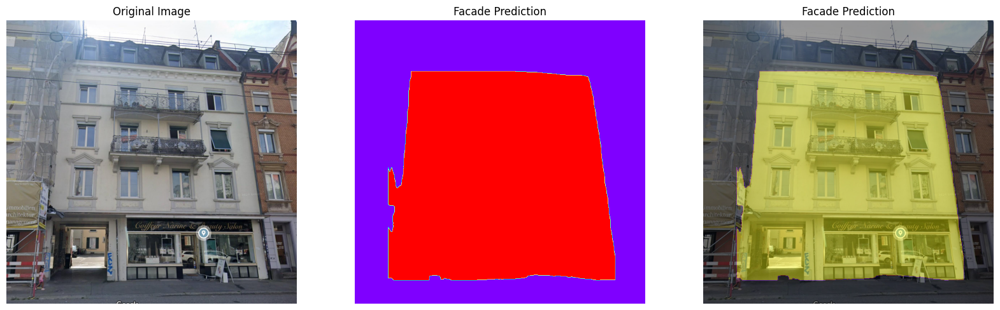

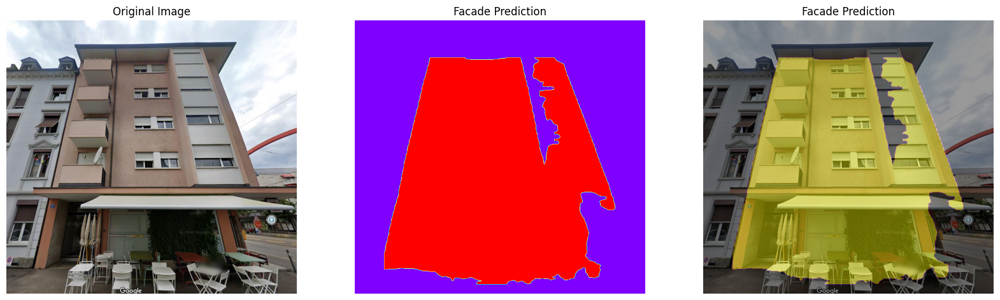

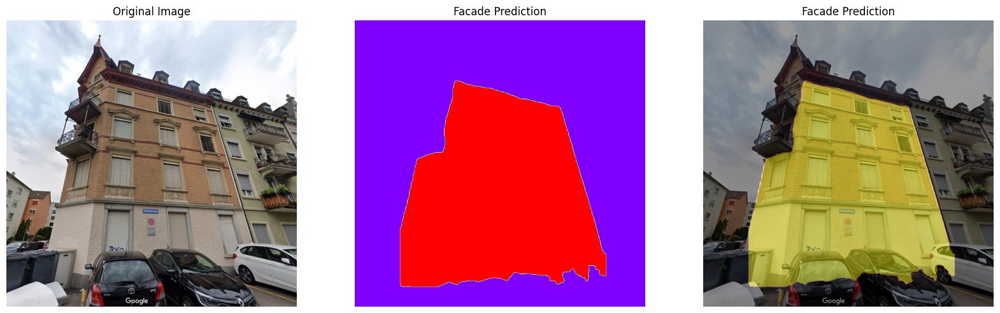

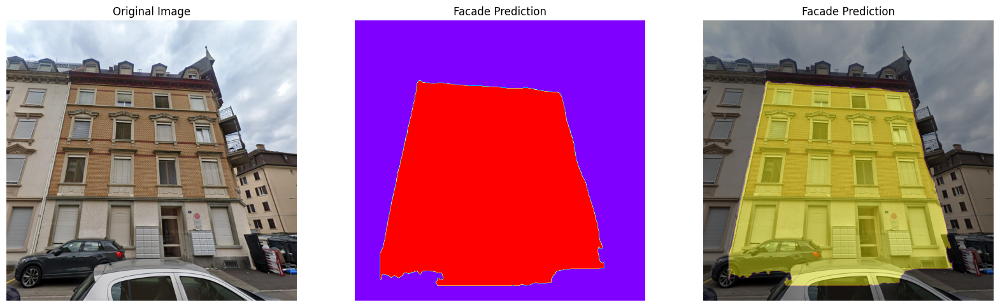

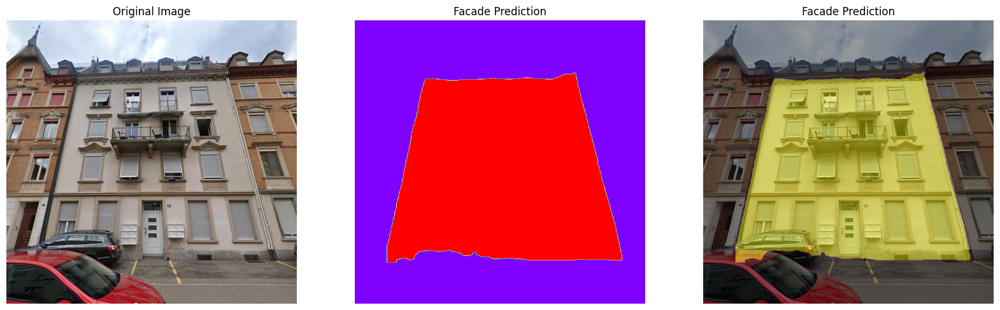

...

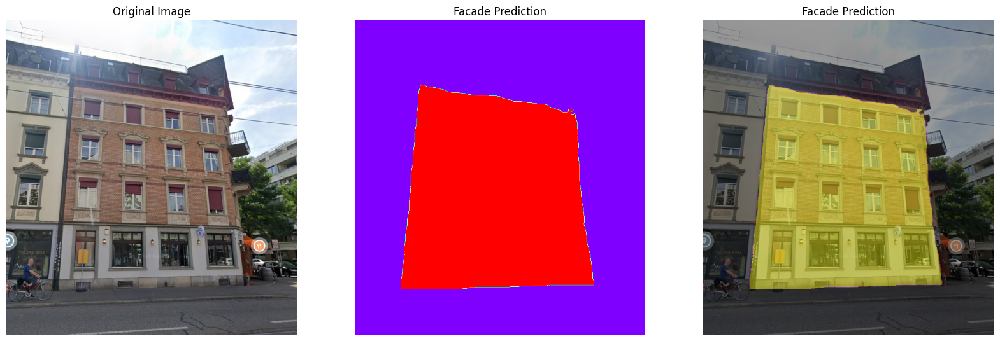

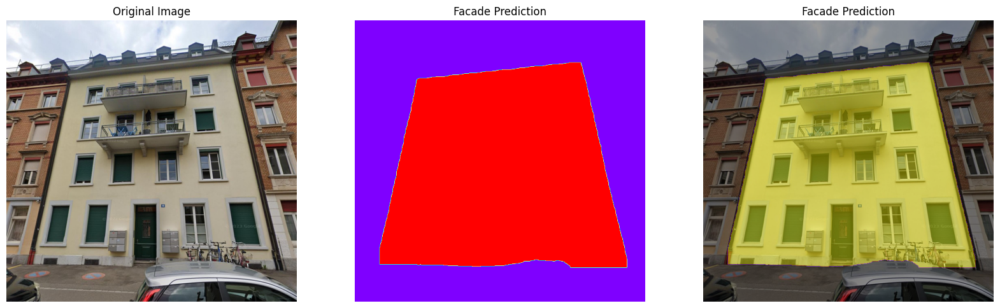

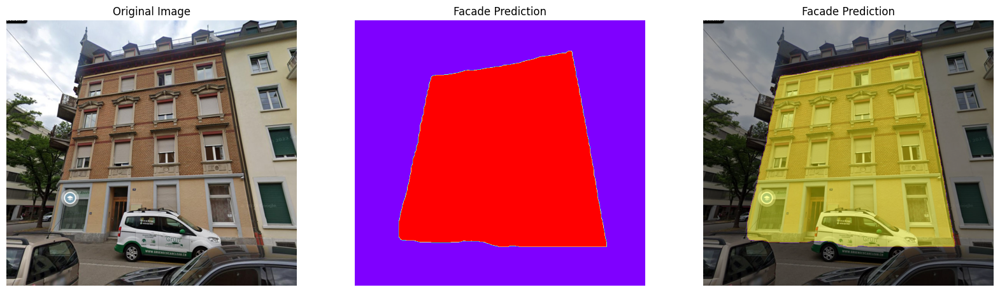

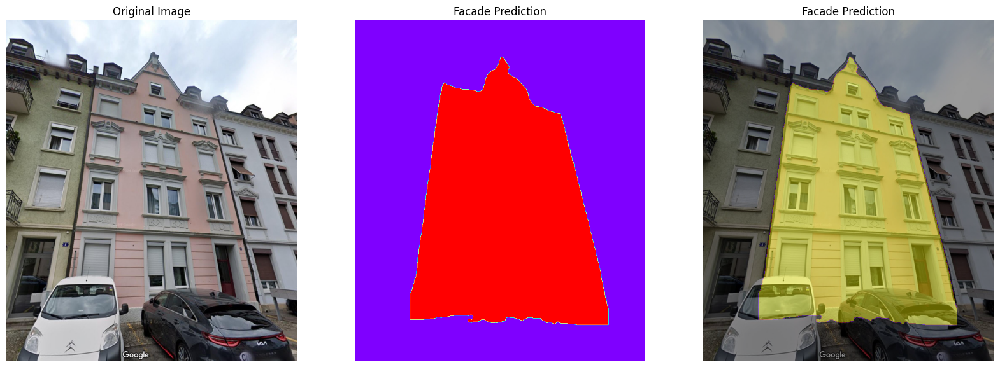

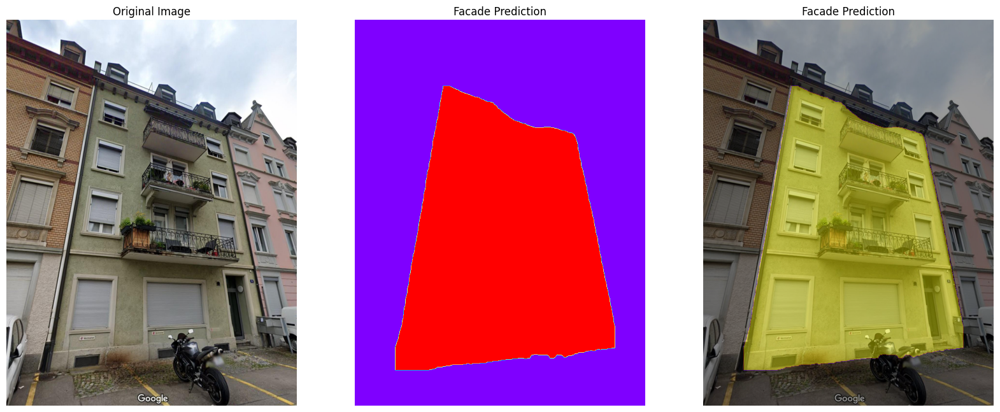

In [ ]:
for filename in tqdm(os.listdir(rootdir)):
    img_path = os.path.join(rootdir, filename)
    facade_prediction_path = os.path.join(save_path, filename.split(".")[0] + ".png")
    fig, axes = plt.subplots(1, 3, figsize=(20, 10))  # Create subplots for two images

    # Plot the original image
    axes[0].imshow(Image.open(img_path))
    axes[0].set_title('Original Image')
    axes[0].axis('off')  # Turn off axis for better visualization

    # Plot the predicted soft mask
    axes[1].imshow(Image.open(facade_prediction_path), cmap="rainbow")  # Squeeze the prediction and show as grayscale
    axes[1].set_title('Facade Prediction')
    axes[1].axis('off')

    axes[2].imshow(Image.open(img_path))
    axes[2].imshow(Image.open(facade_prediction_path), cmap="gnuplot", alpha= 0.4)  # Squeeze the prediction and show as grayscale
    axes[2].set_title('Facade Prediction')
    axes[2].axis('off')

    plt.savefig(os.path.join(save_overlays_path, filename), bbox_inches='tight')
